<a href="https://colab.research.google.com/github/lordpritam/ML-projects/blob/main/90_Animal_Image_Classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
import numpy as np 
import pandas as pd 
import os
import matplotlib.pyplot as plt 
import seaborn as sns
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array, load_img
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Conv2D, MaxPooling2D, GlobalAveragePooling2D, Layer, Flatten
from tensorflow.keras.layers import Activation, Dropout, Flatten, Dense
from tensorflow.keras.applications import VGG16
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau
import warnings
warnings.filterwarnings('ignore')

In [4]:
batch_size = 32
img_size = 224


train_ds = tf.keras.utils.image_dataset_from_directory(
  '/content/drive/MyDrive/animal-image-dataset-90-different-animals/animals/animals',
  validation_split=0.2,
  subset='training',
  image_size=(img_size, img_size),
  batch_size=32,
  seed=42,
  shuffle=True)

val_ds = tf.keras.utils.image_dataset_from_directory(
  '/content/drive/MyDrive/animal-image-dataset-90-different-animals/animals/animals',
  validation_split=0.2,
  subset='validation',
  image_size=(img_size, img_size),
  batch_size=32,
  seed=42,
  shuffle=True)

Found 5400 files belonging to 90 classes.
Using 4320 files for training.
Found 5400 files belonging to 90 classes.
Using 1080 files for validation.


In [5]:
classes = train_ds.class_names
classes

['antelope',
 'badger',
 'bat',
 'bear',
 'bee',
 'beetle',
 'bison',
 'boar',
 'butterfly',
 'cat',
 'caterpillar',
 'chimpanzee',
 'cockroach',
 'cow',
 'coyote',
 'crab',
 'crow',
 'deer',
 'dog',
 'dolphin',
 'donkey',
 'dragonfly',
 'duck',
 'eagle',
 'elephant',
 'flamingo',
 'fly',
 'fox',
 'goat',
 'goldfish',
 'goose',
 'gorilla',
 'grasshopper',
 'hamster',
 'hare',
 'hedgehog',
 'hippopotamus',
 'hornbill',
 'horse',
 'hummingbird',
 'hyena',
 'jellyfish',
 'kangaroo',
 'koala',
 'ladybugs',
 'leopard',
 'lion',
 'lizard',
 'lobster',
 'mosquito',
 'moth',
 'mouse',
 'octopus',
 'okapi',
 'orangutan',
 'otter',
 'owl',
 'ox',
 'oyster',
 'panda',
 'parrot',
 'pelecaniformes',
 'penguin',
 'pig',
 'pigeon',
 'porcupine',
 'possum',
 'raccoon',
 'rat',
 'reindeer',
 'rhinoceros',
 'sandpiper',
 'seahorse',
 'seal',
 'shark',
 'sheep',
 'snake',
 'sparrow',
 'squid',
 'squirrel',
 'starfish',
 'swan',
 'tiger',
 'turkey',
 'turtle',
 'whale',
 'wolf',
 'wombat',
 'woodpecker',


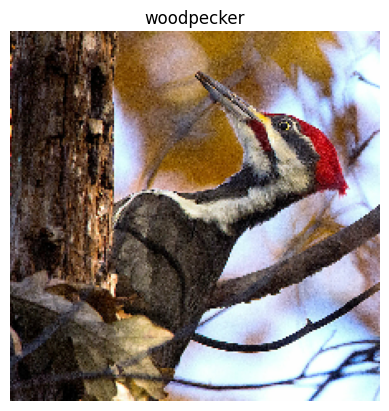

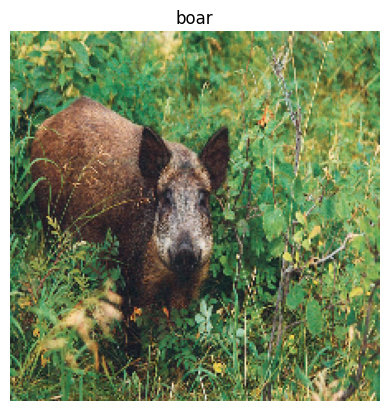

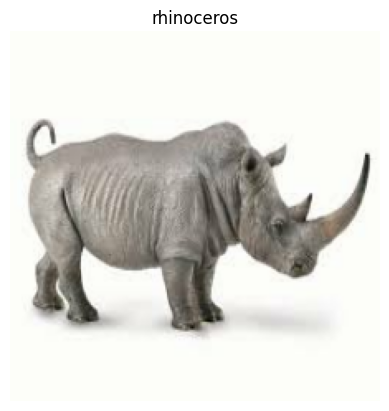

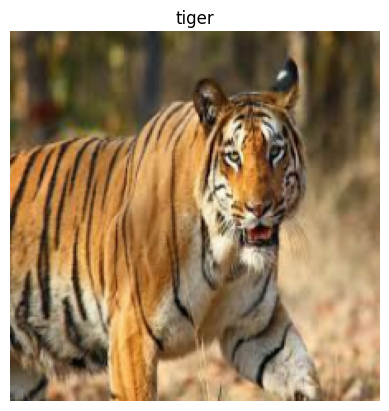

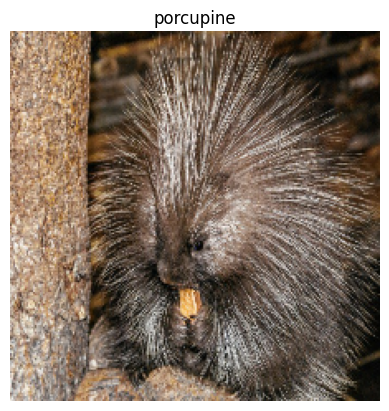

...

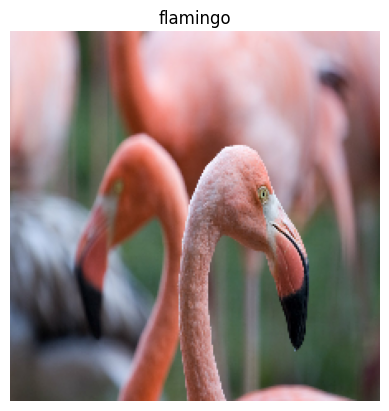

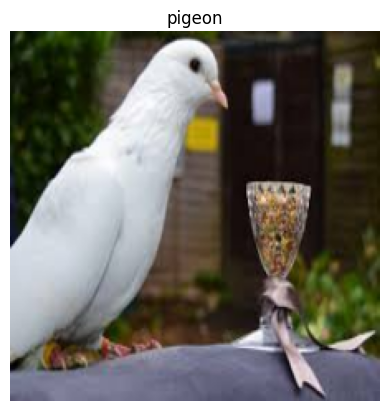

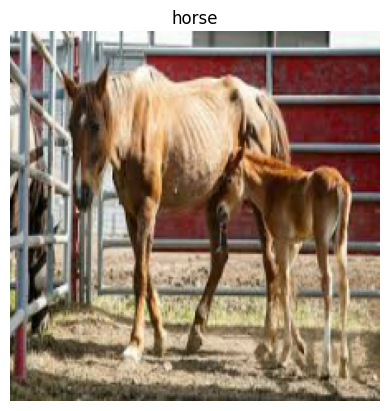

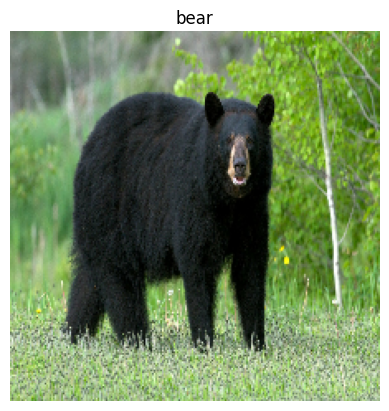

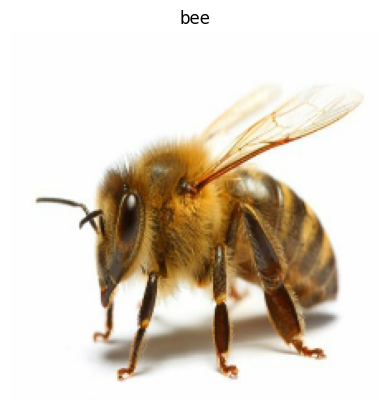

In [6]:
# Get a random batch of images and labels
batch_size = 5
random_batch = train_ds.take(batch_size)

# Iterate over the batch and display the images with class names
for images, labels in random_batch:
    for i in range(batch_size):
        image = images[i].numpy().astype("uint8")
        label = train_ds.class_names[labels[i]]
        
        # Display the image with its class name
        plt.imshow(image)
        plt.title(label)
        plt.axis("off")
        plt.show()

In [9]:
base_model = tf.keras.applications.VGG16(
    include_top=False,
    weights='imagenet',
    input_shape=(img_size, img_size, 3)
)
base_model.trainable = False

In [10]:
inputs = tf.keras.Input(shape=(img_size, img_size, 3))
x = tf.keras.applications.vgg16.preprocess_input(inputs)
x = base_model(x, training=False)
x = tf.keras.layers.GlobalAveragePooling2D()(x)
x = tf.keras.layers.Dropout(0.3)(x)
outputs = tf.keras.layers.Dense(90)(x)
model = tf.keras.Model(inputs, outputs)

model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_3 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 tf.__operators__.getitem (S  (None, 224, 224, 3)      0         
 licingOpLambda)                                                 
                                                                 
 tf.nn.bias_add (TFOpLambda)  (None, 224, 224, 3)      0         
                                                                 
 vgg16 (Functional)          (None, 7, 7, 512)         14714688  
                                                                 
 global_average_pooling2d (G  (None, 512)              0         
 lobalAveragePooling2D)                                          
                                                                 
 dropout (Dropout)           (None, 512)               0     

In [11]:
model.compile(optimizer=tf.keras.optimizers.Adam(0.001),
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

In [12]:
num_epochs = 15
history = model.fit(train_ds, validation_data=val_ds, epochs=num_epochs,
    callbacks = [
        tf.keras.callbacks.EarlyStopping(
            # Stop training when `val_loss` is no longer improving
            monitor="val_loss",
            # "no longer improving" being defined as "no better than 1e-2 less"
            min_delta=1e-2,
            # "no longer improving" being further defined as "for at least 2 epochs"
            patience=2,
            verbose=1,
            restore_best_weights=True
        )
    ]
)

Epoch 1/15
135/135 [==============================] - 1212s 9s/step - loss: 12.2698 - accuracy: 0.1032 - val_loss: 4.0829 - val_accuracy: 0.3583
Epoch 2/15
135/135 [==============================] - 34s 244ms/step - loss: 4.5308 - accuracy: 0.4005 - val_loss: 2.0740 - val_accuracy: 0.5954
Epoch 3/15
135/135 [==============================] - 35s 249ms/step - loss: 2.5581 - accuracy: 0.5787 - val_loss: 1.5412 - val_accuracy: 0.7000
Epoch 4/15
135/135 [==============================] - 36s 257ms/step - loss: 1.7211 - accuracy: 0.6845 - val_loss: 1.3747 - val_accuracy: 0.7324
Epoch 5/15
135/135 [==============================] - 37s 268ms/step - loss: 1.2312 - accuracy: 0.7484 - val_loss: 1.3647 - val_accuracy: 0.7528
Epoch 6/15
135/135 [==============================] - 33s 238ms/step - loss: 0.9963 - accuracy: 0.7852 - val_loss: 1.1283 - val_accuracy: 0.7870
Epoch 7/15
135/135 [==============================] - 35s 253ms/step - loss: 0.7890 - accuracy: 0.8160 - val_loss: 1.1396 - val_ac

In [13]:
# Evaluate the model on the validation data.
model.evaluate(val_ds, steps=len(val_ds))

34/34 [==============================] - 7s 162ms/step - loss: 1.1283 - accuracy: 0.7870


[1.1283209323883057, 0.7870370149612427]

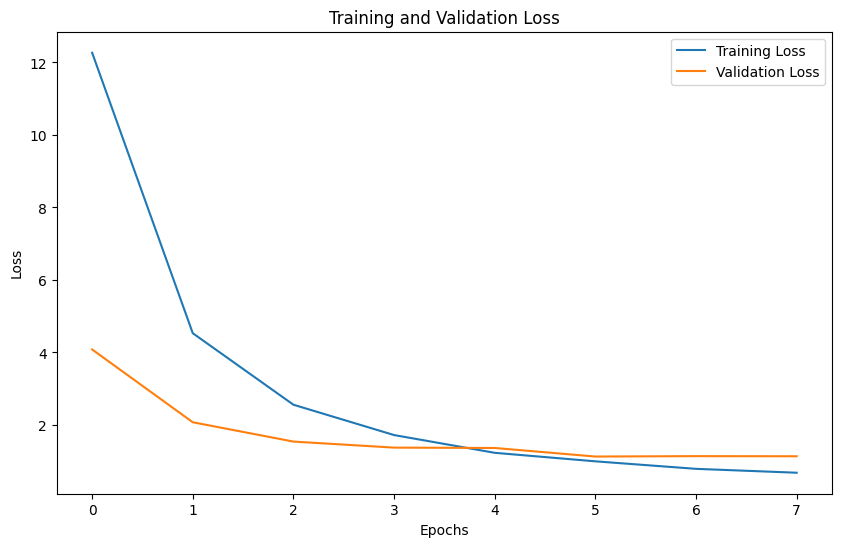

In [14]:
# Plot training and validation loss
plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.title('Training and Validation Loss')
plt.show()

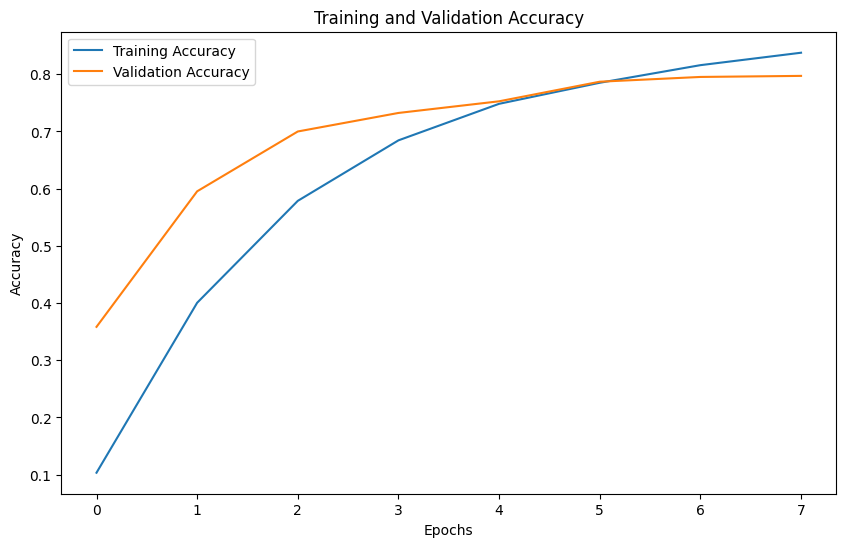

In [15]:
# Plot training and validation accuracy
plt.figure(figsize=(10, 6))
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.title('Training and Validation Accuracy')
plt.show()

1/1 [==============================] - 1s 1s/step


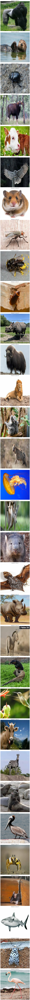

1/1 [==============================] - 0s 75ms/step


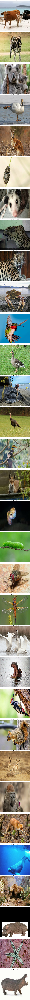

1/1 [==============================] - 0s 75ms/step


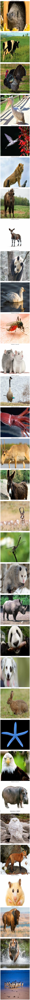

1/1 [==============================] - 0s 67ms/step


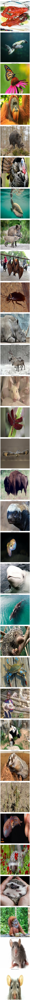

In [ ]:
# Iterate over the validation dataset and make predictions
for images, labels in val_ds:
    predictions = model.predict(images)
    predicted_labels = tf.argmax(predictions, axis=1)

    # Plot the images with their predicted and actual labels
    fig, axes = plt.subplots(len(images), 1, figsize=(4, 4*len(images)))
    for i, (image, predicted_label, actual_label) in enumerate(zip(images, predicted_labels, labels)):
        ax = axes[i] if len(images) > 1 else axes
        ax.imshow(image.numpy().astype("uint8"))
        ax.set_title(f"Predicted: {predicted_label}, Actual: {actual_label}")
        ax.axis("off")

    plt.tight_layout()
    plt.show()